In [1]:
import os
os.environ["KMP_DUPLICATE_LIB_OK"]="TRUE"

In [2]:
%matplotlib inline
%load_ext autoreload
%autoreload 2

import os
import sys
import time
import copy
import torch
import numpy as np
import motmetrics as mm
import matplotlib.pyplot as plt

from tqdm.autonotebook import tqdm
from torch.utils.data import DataLoader

mm.lap.default_solver = 'lap'


C:\Users\pirat\anaconda3\envs\CV3\lib\site-packages\tqdm\auto.py:22: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


In [3]:
sys.path.append(os.path.join("../", 'src'))

In [4]:
from data.mot_16_track import MOT16Sequences
from utils.utils import (plot_sequence,plot_mot_sequences,run_tracker)

In [5]:
data_dir = os.path.join('../', 'data/MOT16')
object_detector_file_path = os.path.join('../', 'models/faster_rcnn_fpn.model')
reid_feature_extractor_file_path=os.path.join('../', 'models/final-reid_model.pth')

device = torch.device('cuda') if torch.cuda.is_available() else torch.device('cpu')

## MOT16 dataset

The MOT16 challenge provides 7 train and 7 test video sequences with multiple objects (pedestrians) per frame. It includes many challening scenarios with camera movement, high crowdedness and object occlusions. See the [webpage](https://motchallenge.net/data/MOT16/) for video sequences with ground truth annotation.

The `MOT16Sequences` dataset class provides the possibilty to load single sequences, e.g., `seq_name = 'mot16_02'`, or the entire train/test set, e.g., `seq_name = 'mot16_train'`.

Instance segmentations for the sequences `02`, `05`, `09` and `11` is provided.
See the original MOTS [webpage](https://www.vision.rwth-aachen.de/page/mots) for more info.

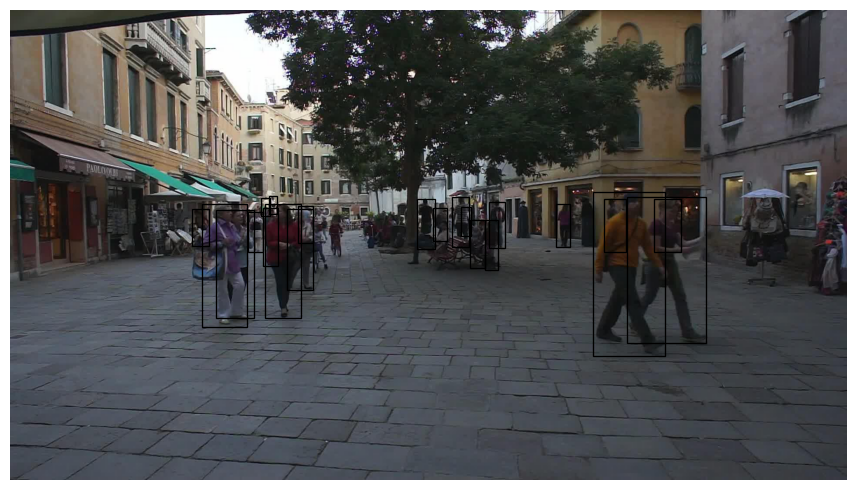

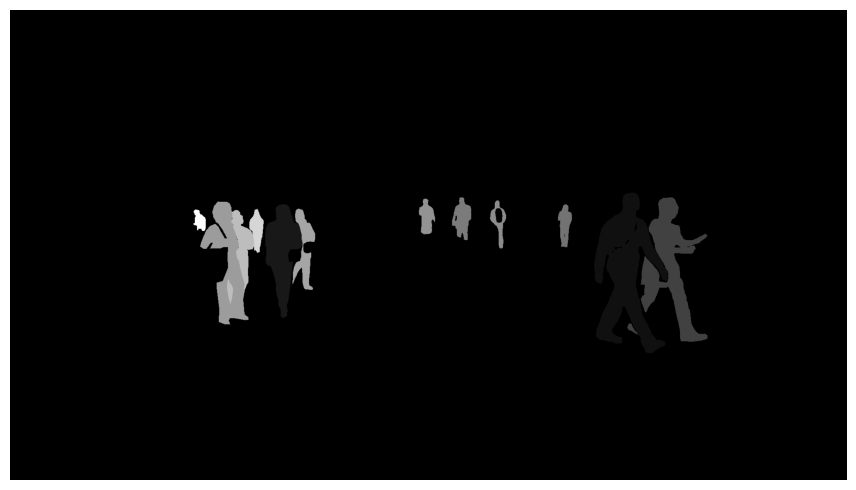

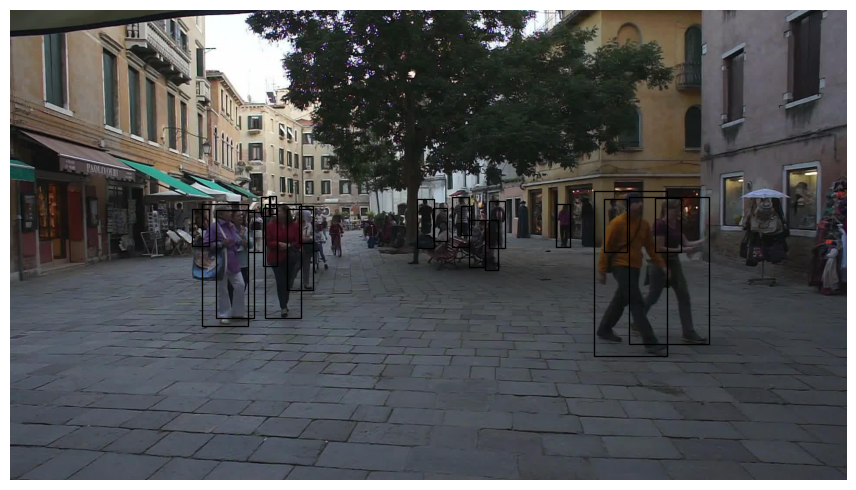

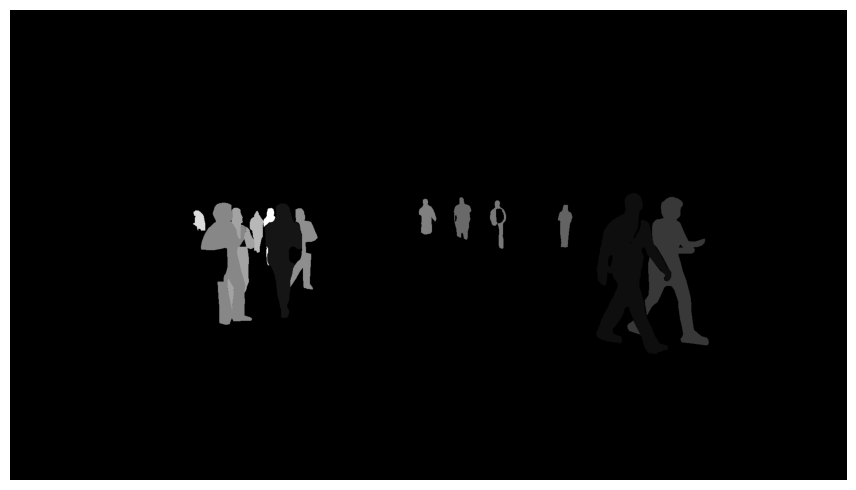

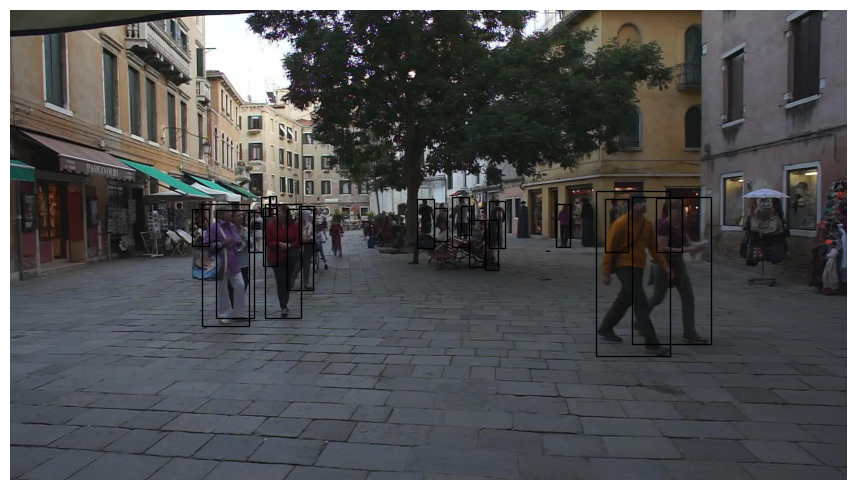

...

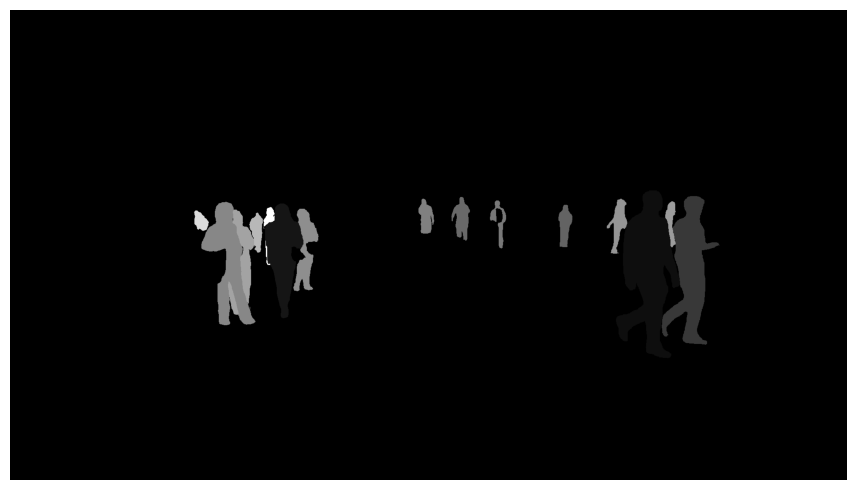

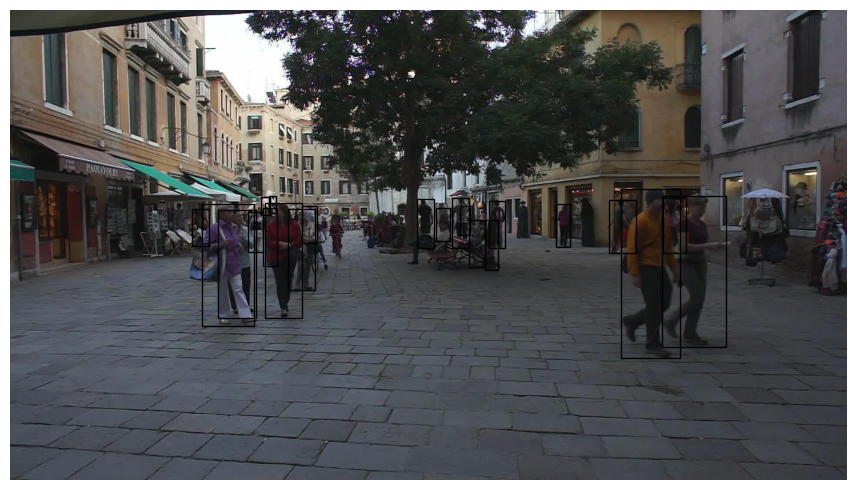

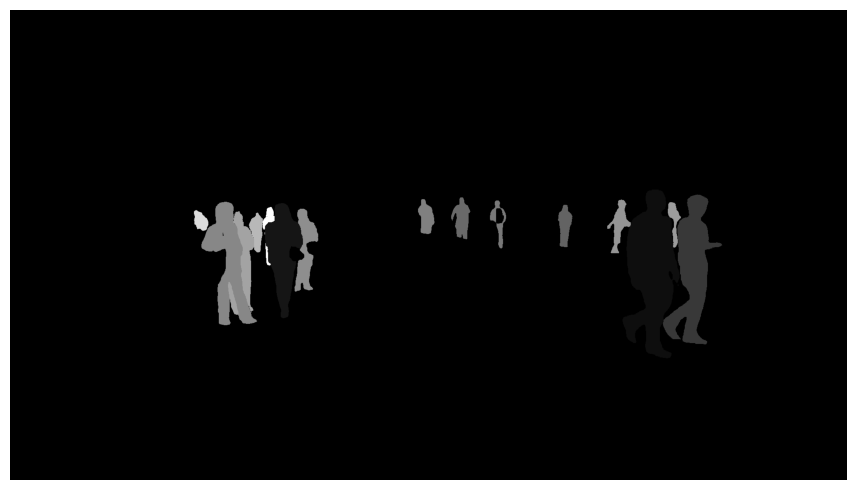

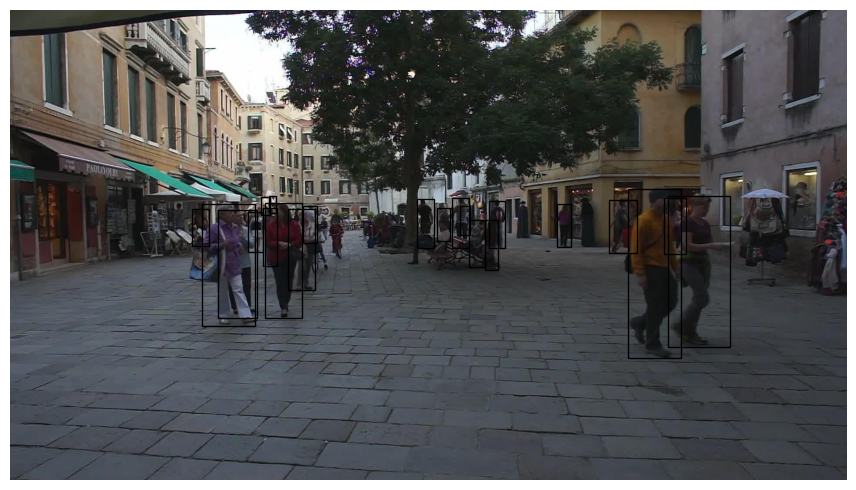

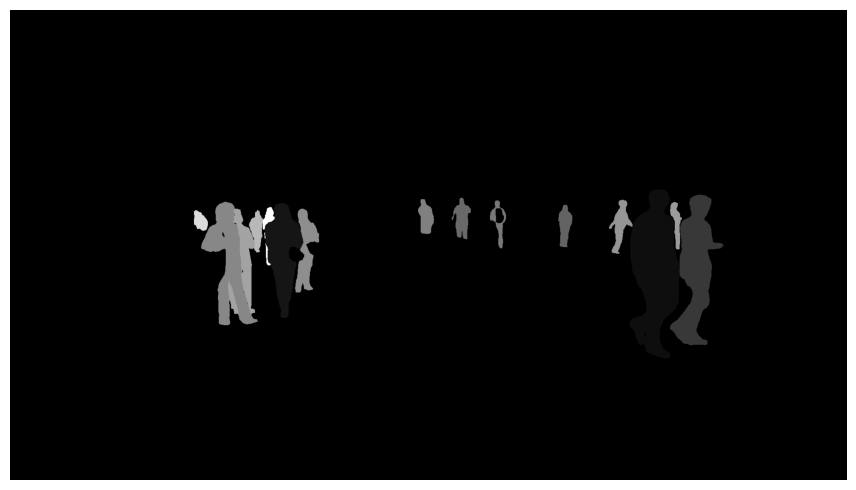

In [6]:
seq_name = 'MOT16-02'
load_seg=True
limit=10
plot_mot_sequences('MOT16-02',data_dir,load_seg,limit=limit)

In [7]:
from models.object_detector import FRCNN_FPN
# object detector
obj_detect_nms_thresh = 0.3
obj_detect = FRCNN_FPN(num_classes=2, nms_thresh=obj_detect_nms_thresh)
obj_detect_state_dict = torch.load(object_detector_file_path,map_location=lambda storage, loc: storage)
obj_detect.load_state_dict(obj_detect_state_dict)
obj_detect.eval()
obj_detect.to(device)
print()

C:\Users\pirat\anaconda3\envs\CV3\lib\site-packages\torchvision\models\_utils.py:135: UserWarning: Using 'backbone_name' and 'weights' as positional parameter(s) is deprecated since 0.13 and may be removed in the future. Please use keyword parameter(s) instead.
  warnings.warn(
C:\Users\pirat\anaconda3\envs\CV3\lib\site-packages\torchvision\models\_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=None`.
  warnings.warn(msg)


In [8]:
from trackers.iou_tracker import IoUAssignmentTracker
seq_name = 'MOT16-02'
output_dir='../outputs/IOU_Tracker'
inactive_pateince=60
sequences = MOT16Sequences(seq_name, data_dir, load_seg=False)
iou_tracker=IoUAssignmentTracker(obj_detect,inactive_pateince=inactive_pateince)
iou_tracker_results_seq=run_tracker(iou_tracker,sequences,output_dir)

Tracking: MOT16-02


100%|██████████| 600/600 [03:32<00:00,  2.82it/s]


Tracks found: 362
Runtime for MOT16-02: 289.1 s.
Writing predictions to: ../outputs/IOU_Tracker\MOT16-02.txt
Runtime for all sequences: 289.1 s.


C:\Users\pirat\anaconda3\envs\CV3\lib\site-packages\motmetrics\mot.py:344: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  r = r.append(copy)
C:\Users\pirat\anaconda3\envs\CV3\lib\site-packages\motmetrics\metrics.py:336: FutureWarning: iteritems is deprecated and will be removed in a future version. Use .items instead.
  for h, ex in df_o.groupby(level=0).count().iteritems():
C:\Users\pirat\anaconda3\envs\CV3\lib\site-packages\motmetrics\metrics.py:336: FutureWarning: iteritems is deprecated and will be removed in a future version. Use .items instead.
  for h, ex in df_o.groupby(level=0).count().iteritems():
C:\Users\pirat\anaconda3\envs\CV3\lib\site-packages\motmetrics\metrics.py:336: FutureWarning: iteritems is deprecated and will be removed in a future version. Use .items instead.
  for h, ex in df_o.groupby(level=0).count().iteritems():
C:\Users\pirat\anaconda3\envs\CV3\lib\site-packages\motmetri

C:\Users\pirat\anaconda3\envs\CV3\lib\site-packages\motmetrics\metrics.py:336: FutureWarning: iteritems is deprecated and will be removed in a future version. Use .items instead.
  for h, ex in df_o.groupby(level=0).count().iteritems():
C:\Users\pirat\anaconda3\envs\CV3\lib\site-packages\motmetrics\metrics.py:336: FutureWarning: iteritems is deprecated and will be removed in a future version. Use .items instead.
  for h, ex in df_o.groupby(level=0).count().iteritems():
C:\Users\pirat\anaconda3\envs\CV3\lib\site-packages\motmetrics\metrics.py:336: FutureWarning: iteritems is deprecated and will be removed in a future version. Use .items instead.
  for h, ex in df_o.groupby(level=0).count().iteritems():
C:\Users\pirat\anaconda3\envs\CV3\lib\site-packages\motmetrics\metrics.py:336: FutureWarning: iteritems is deprecated and will be removed in a future version. Use .items instead.
  for h, ex in df_o.groupby(level=0).count().iteritems():
C:\Users\pirat\anaconda3\envs\CV3\lib\site-packages\

          IDF1   IDP   IDR  Rcll  Prcn GT MT PT ML  FP   FN IDs   FM  MOTA  MOTP
MOT16-02 40.8% 57.9% 31.5% 52.2% 96.1% 62 12 37 13 395 8875 203  210 49.0% 0.090
OVERALL  40.8% 57.9% 31.5% 52.2% 96.1% 62 12 37 13 395 8875 203  210 49.0% 0.090


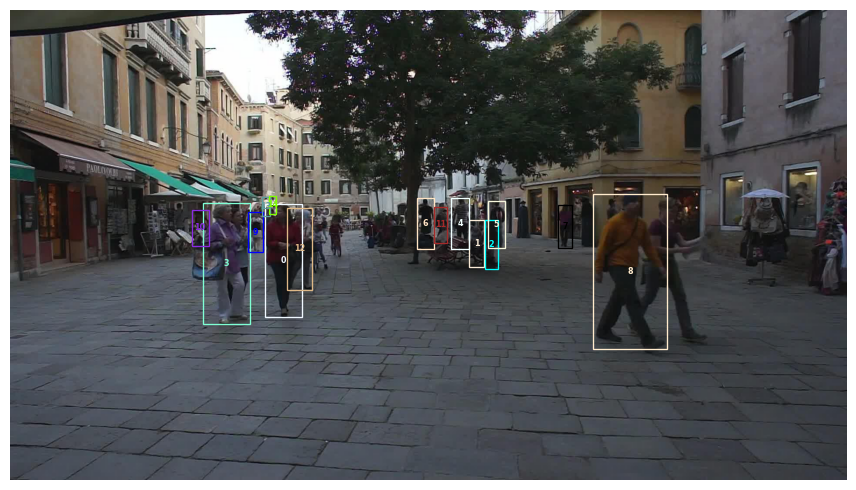

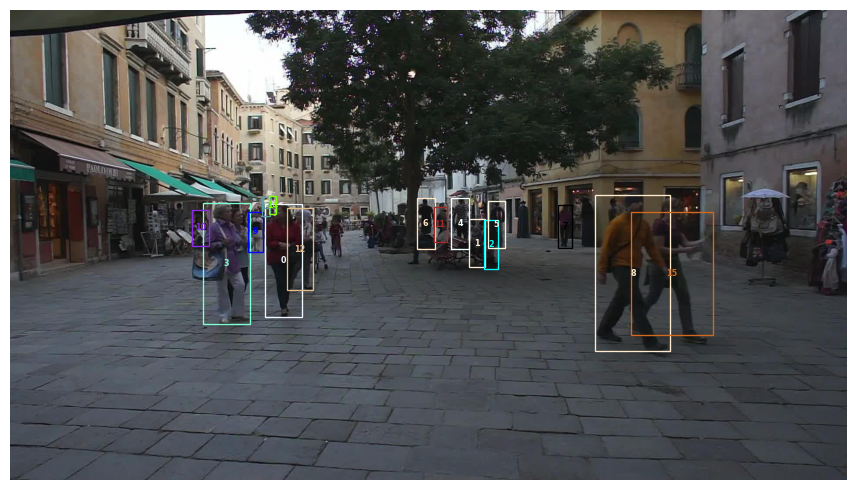

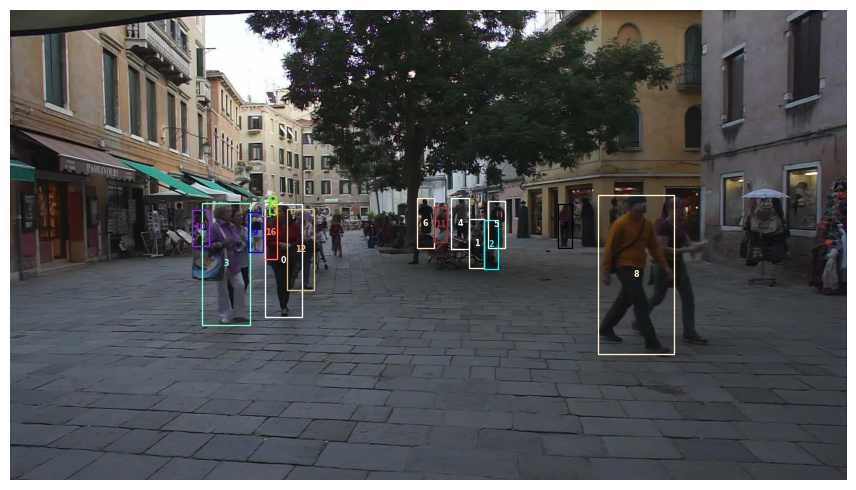

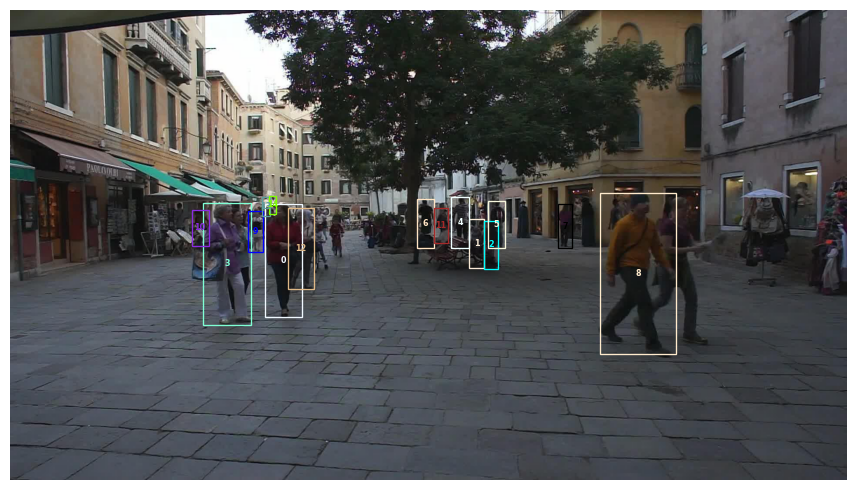

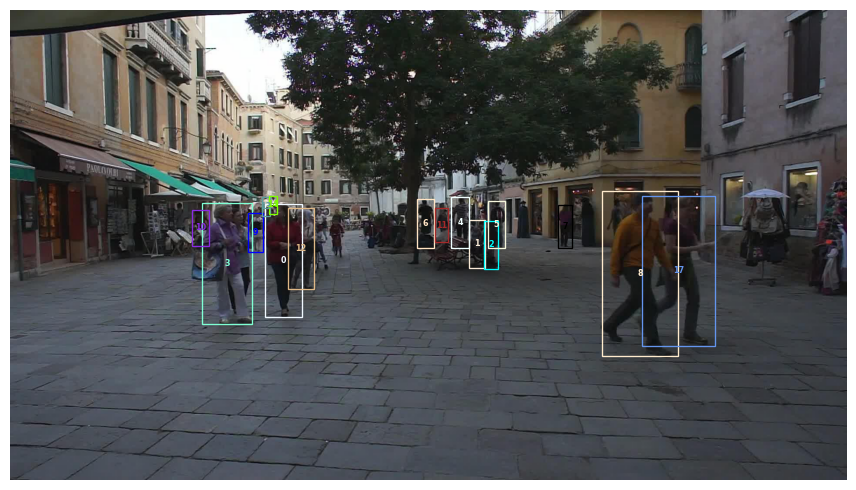

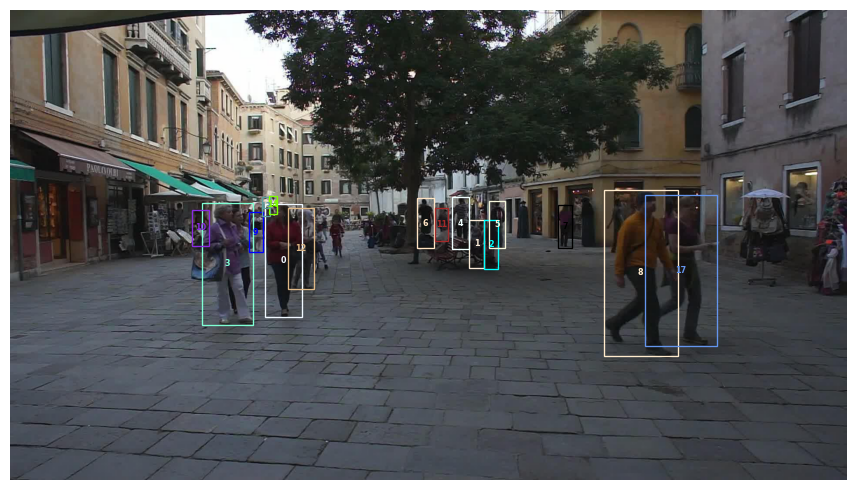

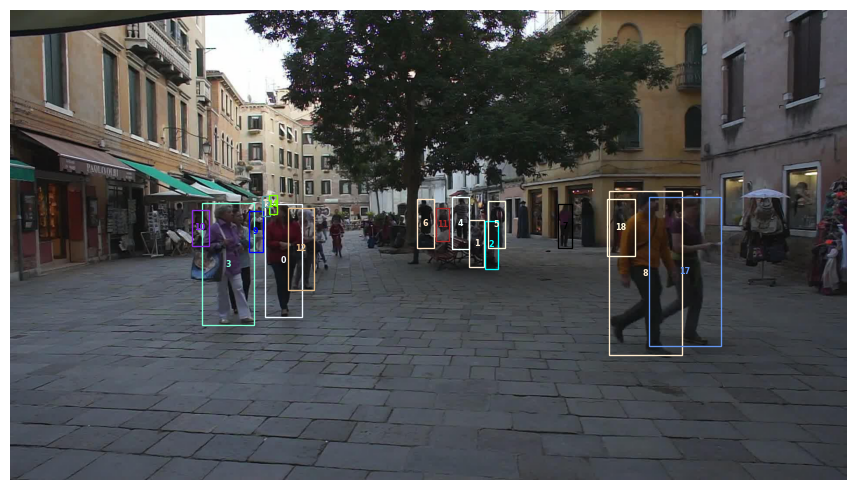

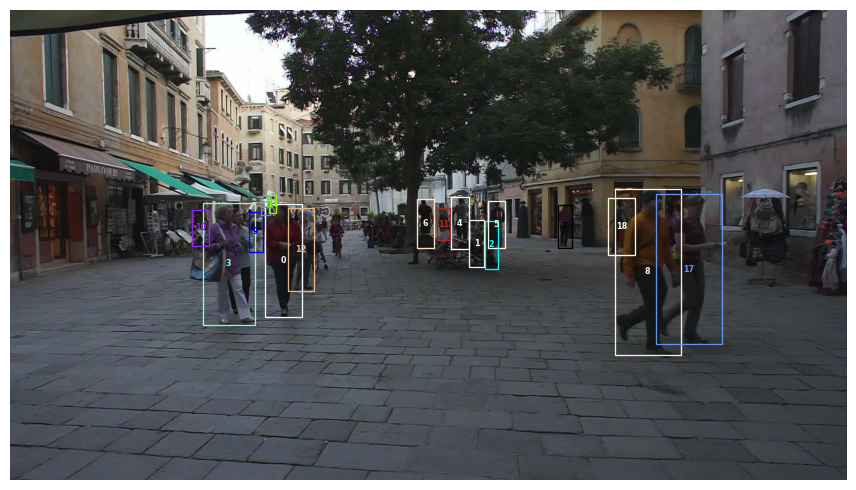

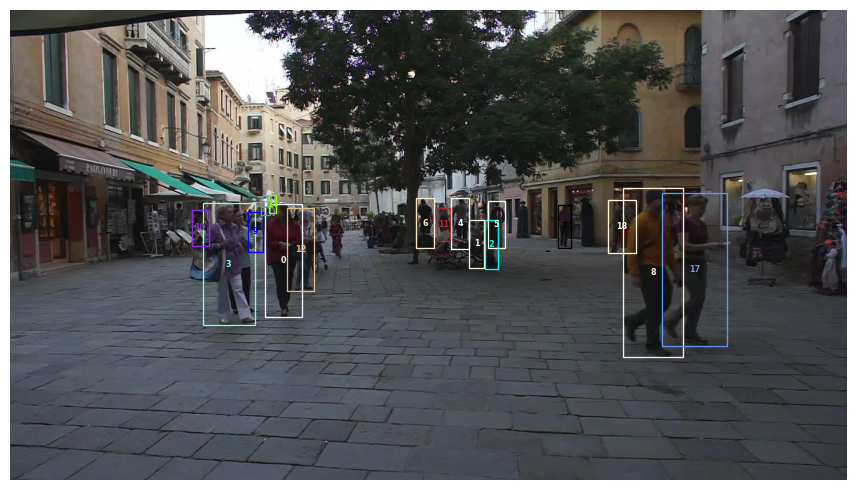

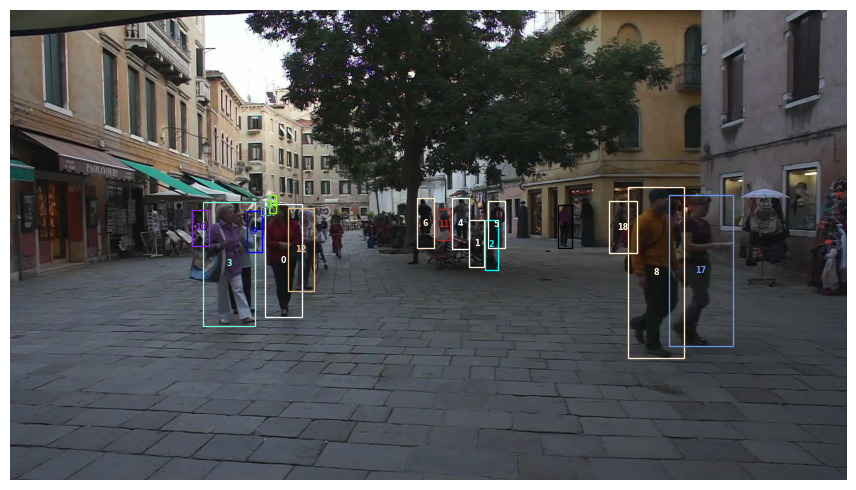

In [9]:
plot_sequence(iou_tracker_results_seq['MOT16-02'],[s for s in sequences if str(s) == 'MOT16-02'][0],first_n_frames=10)

In [10]:
from trackers.hungarian_iou_tracker import HungarianIoUTracker
seq_name = 'MOT16-02'
output_dir='../outputs/Hungarian_IOU_Tracker'
inactive_pateince=60
sequences = MOT16Sequences(seq_name, data_dir, load_seg=False)
hungarian_iou_tracker=HungarianIoUTracker(obj_detect,inactive_pateince=inactive_pateince)
hungarian_iou_tracker_results_seq=run_tracker(hungarian_iou_tracker,sequences,output_dir)

Tracking: MOT16-02


100%|██████████| 600/600 [03:45<00:00,  2.66it/s]


Tracks found: 160
Runtime for MOT16-02: 303.7 s.
Writing predictions to: ../outputs/Hungarian_IOU_Tracker\MOT16-02.txt
Runtime for all sequences: 303.7 s.


C:\Users\pirat\anaconda3\envs\CV3\lib\site-packages\motmetrics\mot.py:344: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  r = r.append(copy)
C:\Users\pirat\anaconda3\envs\CV3\lib\site-packages\motmetrics\metrics.py:336: FutureWarning: iteritems is deprecated and will be removed in a future version. Use .items instead.
  for h, ex in df_o.groupby(level=0).count().iteritems():
C:\Users\pirat\anaconda3\envs\CV3\lib\site-packages\motmetrics\metrics.py:336: FutureWarning: iteritems is deprecated and will be removed in a future version. Use .items instead.
  for h, ex in df_o.groupby(level=0).count().iteritems():
C:\Users\pirat\anaconda3\envs\CV3\lib\site-packages\motmetrics\metrics.py:336: FutureWarning: iteritems is deprecated and will be removed in a future version. Use .items instead.
  for h, ex in df_o.groupby(level=0).count().iteritems():
C:\Users\pirat\anaconda3\envs\CV3\lib\site-packages\motmetri

C:\Users\pirat\anaconda3\envs\CV3\lib\site-packages\motmetrics\metrics.py:336: FutureWarning: iteritems is deprecated and will be removed in a future version. Use .items instead.
  for h, ex in df_o.groupby(level=0).count().iteritems():
C:\Users\pirat\anaconda3\envs\CV3\lib\site-packages\motmetrics\metrics.py:336: FutureWarning: iteritems is deprecated and will be removed in a future version. Use .items instead.
  for h, ex in df_o.groupby(level=0).count().iteritems():
C:\Users\pirat\anaconda3\envs\CV3\lib\site-packages\motmetrics\metrics.py:336: FutureWarning: iteritems is deprecated and will be removed in a future version. Use .items instead.
  for h, ex in df_o.groupby(level=0).count().iteritems():
C:\Users\pirat\anaconda3\envs\CV3\lib\site-packages\motmetrics\metrics.py:336: FutureWarning: iteritems is deprecated and will be removed in a future version. Use .items instead.
  for h, ex in df_o.groupby(level=0).count().iteritems():
C:\Users\pirat\anaconda3\envs\CV3\lib\site-packages\

          IDF1   IDP   IDR  Rcll  Prcn GT MT PT ML  FP   FN IDs   FM  MOTA  MOTP
MOT16-02 50.8% 72.1% 39.2% 52.2% 96.2% 62 12 37 13 383 8875 113  214 49.6% 0.090
OVERALL  50.8% 72.1% 39.2% 52.2% 96.2% 62 12 37 13 383 8875 113  214 49.6% 0.090


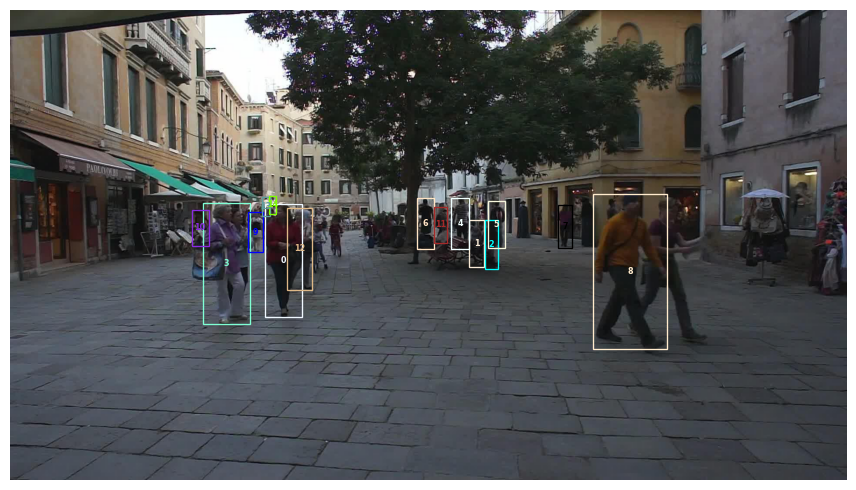

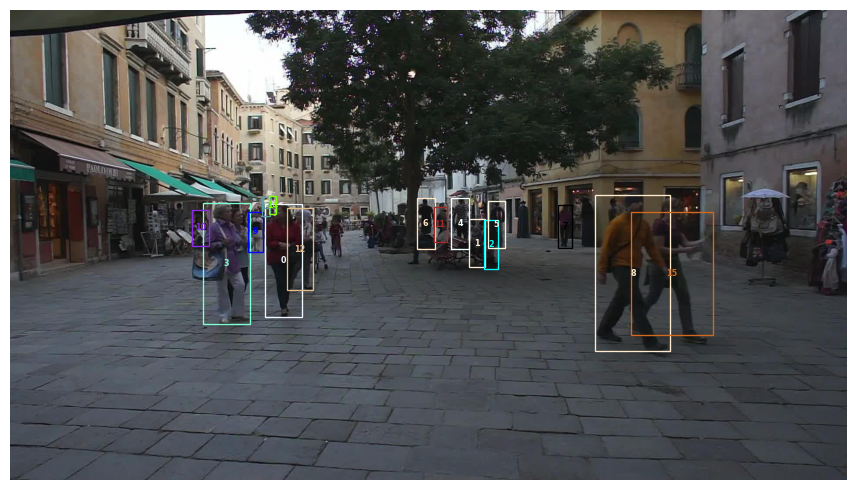

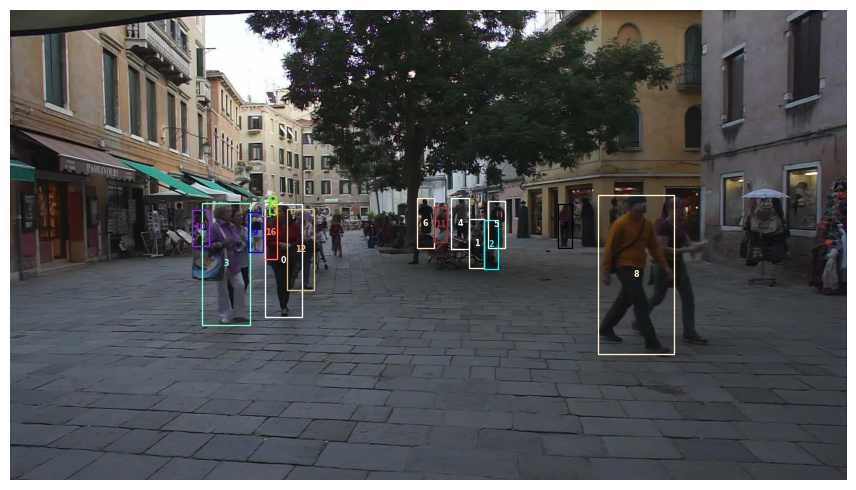

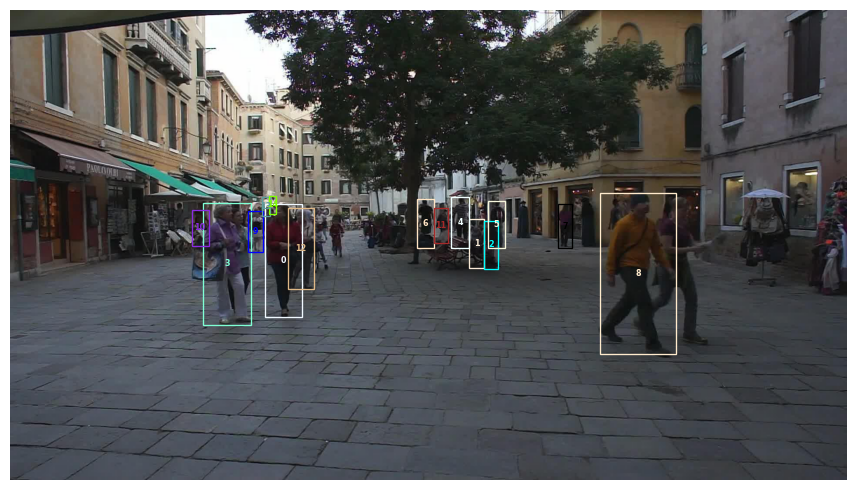

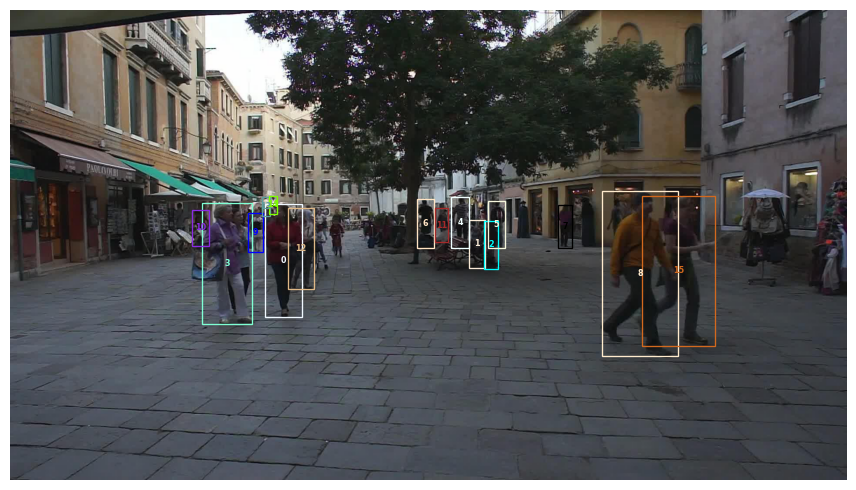

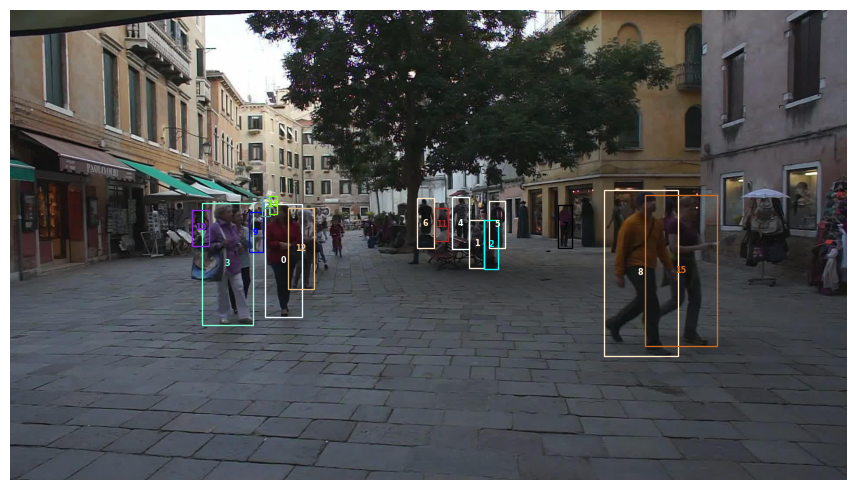

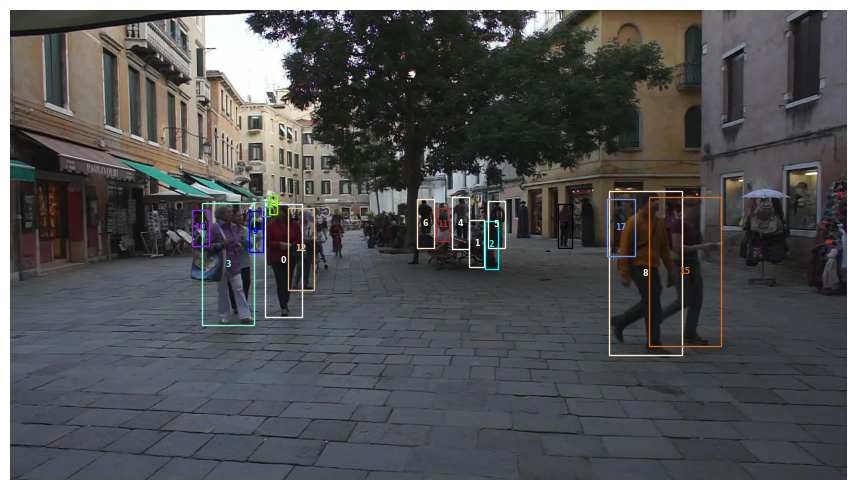

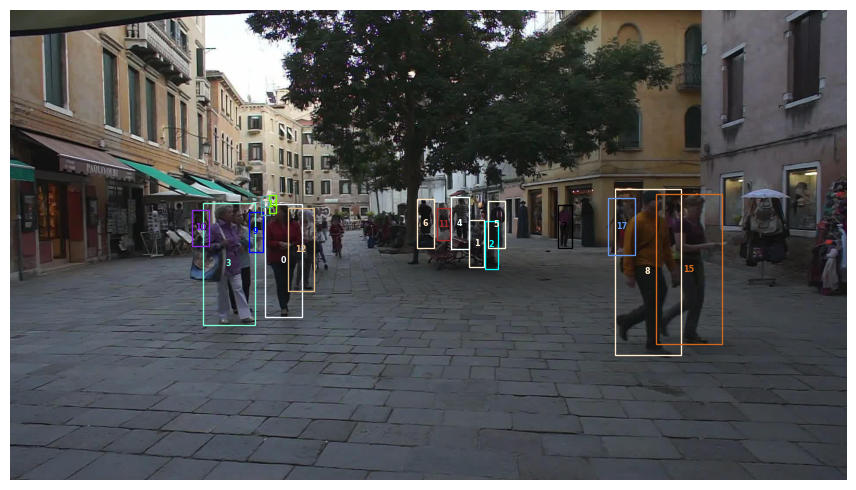

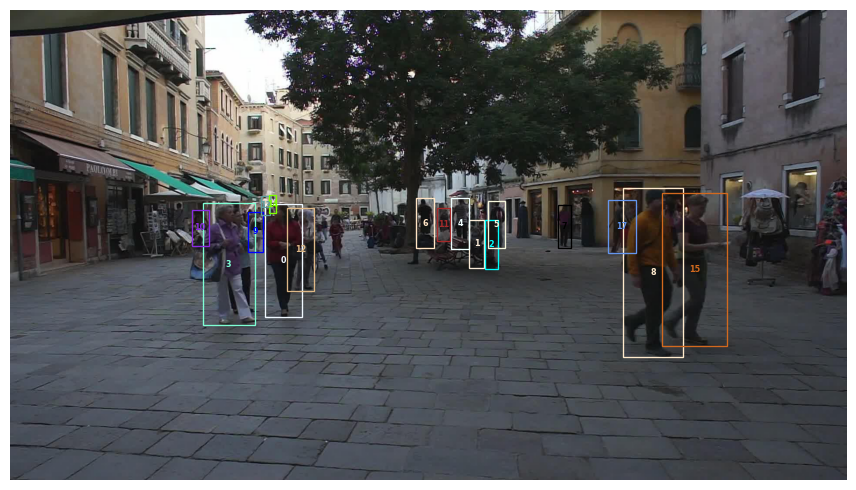

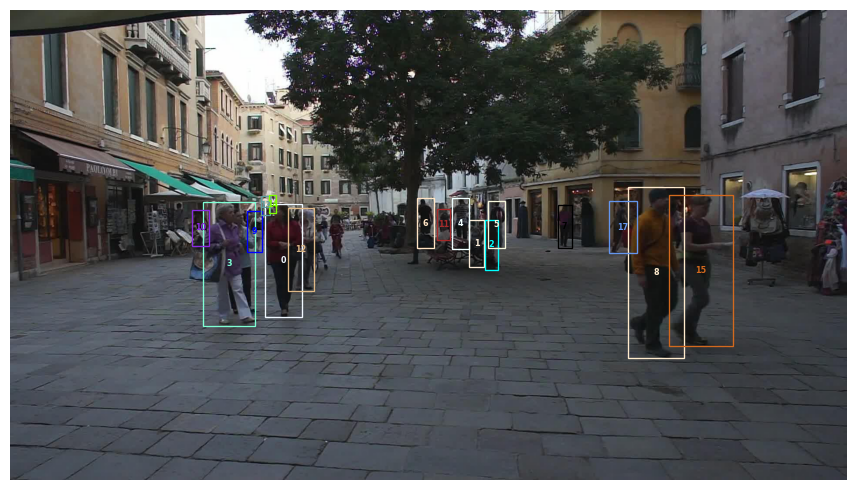

In [11]:
plot_sequence(hungarian_iou_tracker_results_seq['MOT16-02'],[s for s in sequences if str(s) == 'MOT16-02'][0],first_n_frames=10)

In [12]:
from trackers.reid_hungarian_iou_tracker import ReIDTracker
#Reid Network
feature_extractor = torch.load(reid_feature_extractor_file_path)
seq_name = 'MOT16-02'
output_dir='../outputs/ReID_Tracker'
inactive_pateince=60
sequences = MOT16Sequences(seq_name, data_dir, load_seg=False)
reid_tracker=ReIDTracker(feature_extractor,obj_detect,inactive_pateince=inactive_pateince)
reid_tracker_results_seq=run_tracker(reid_tracker,sequences,output_dir)

Tracking: MOT16-02


100%|██████████| 600/600 [09:38<00:00,  1.04it/s]


Tracks found: 157
Runtime for MOT16-02: 623.2 s.
Writing predictions to: ../outputs/ReID_Tracker\MOT16-02.txt
Runtime for all sequences: 623.2 s.


C:\Users\pirat\anaconda3\envs\CV3\lib\site-packages\motmetrics\mot.py:344: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  r = r.append(copy)
C:\Users\pirat\anaconda3\envs\CV3\lib\site-packages\motmetrics\metrics.py:336: FutureWarning: iteritems is deprecated and will be removed in a future version. Use .items instead.
  for h, ex in df_o.groupby(level=0).count().iteritems():
C:\Users\pirat\anaconda3\envs\CV3\lib\site-packages\motmetrics\metrics.py:336: FutureWarning: iteritems is deprecated and will be removed in a future version. Use .items instead.
  for h, ex in df_o.groupby(level=0).count().iteritems():
C:\Users\pirat\anaconda3\envs\CV3\lib\site-packages\motmetrics\metrics.py:336: FutureWarning: iteritems is deprecated and will be removed in a future version. Use .items instead.
  for h, ex in df_o.groupby(level=0).count().iteritems():
C:\Users\pirat\anaconda3\envs\CV3\lib\site-packages\motmetri

C:\Users\pirat\anaconda3\envs\CV3\lib\site-packages\motmetrics\metrics.py:336: FutureWarning: iteritems is deprecated and will be removed in a future version. Use .items instead.
  for h, ex in df_o.groupby(level=0).count().iteritems():
C:\Users\pirat\anaconda3\envs\CV3\lib\site-packages\motmetrics\metrics.py:336: FutureWarning: iteritems is deprecated and will be removed in a future version. Use .items instead.
  for h, ex in df_o.groupby(level=0).count().iteritems():
C:\Users\pirat\anaconda3\envs\CV3\lib\site-packages\motmetrics\metrics.py:336: FutureWarning: iteritems is deprecated and will be removed in a future version. Use .items instead.
  for h, ex in df_o.groupby(level=0).count().iteritems():
C:\Users\pirat\anaconda3\envs\CV3\lib\site-packages\motmetrics\metrics.py:336: FutureWarning: iteritems is deprecated and will be removed in a future version. Use .items instead.
  for h, ex in df_o.groupby(level=0).count().iteritems():
C:\Users\pirat\anaconda3\envs\CV3\lib\site-packages\

          IDF1   IDP   IDR  Rcll  Prcn GT MT PT ML  FP   FN IDs   FM  MOTA  MOTP
MOT16-02 49.1% 69.8% 37.9% 52.2% 96.2% 62 12 37 13 383 8875 118  215 49.5% 0.090
OVERALL  49.1% 69.8% 37.9% 52.2% 96.2% 62 12 37 13 383 8875 118  215 49.5% 0.090


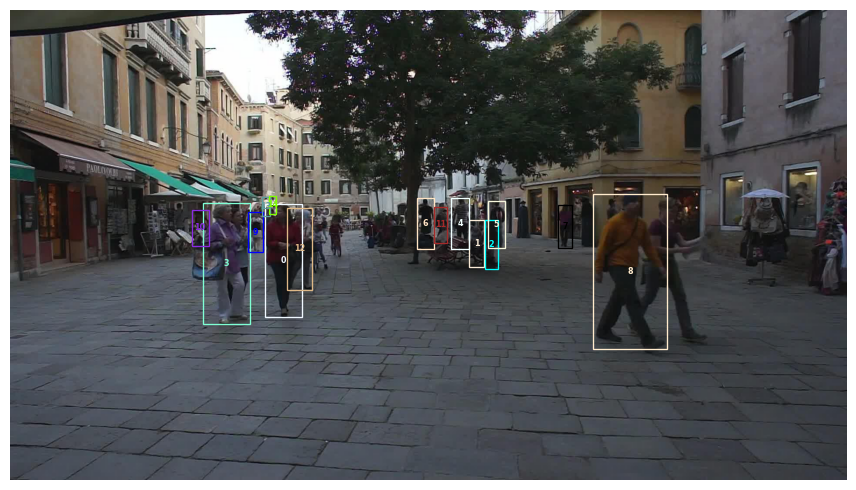

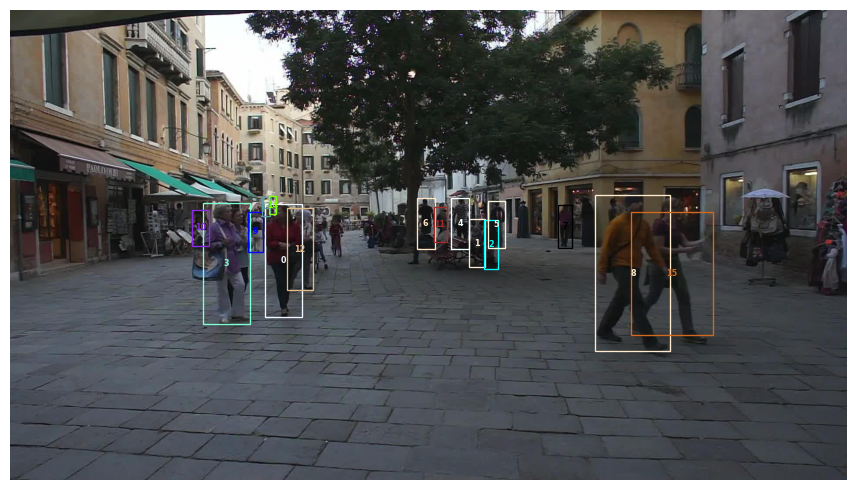

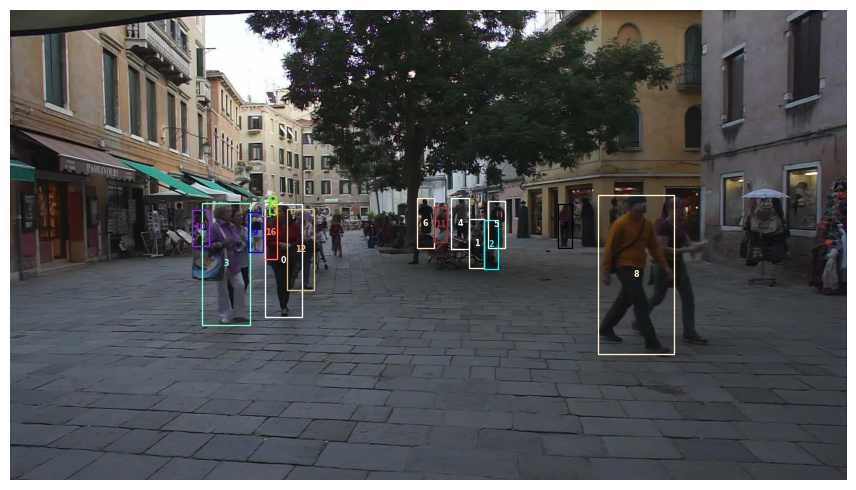

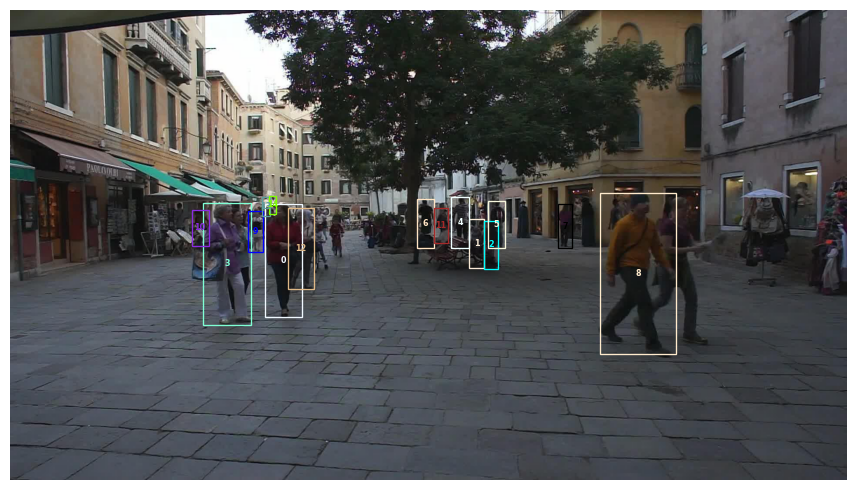

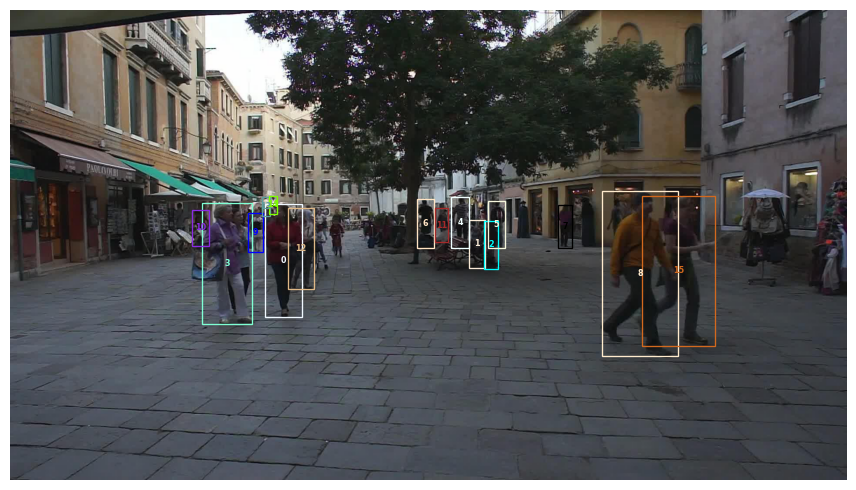

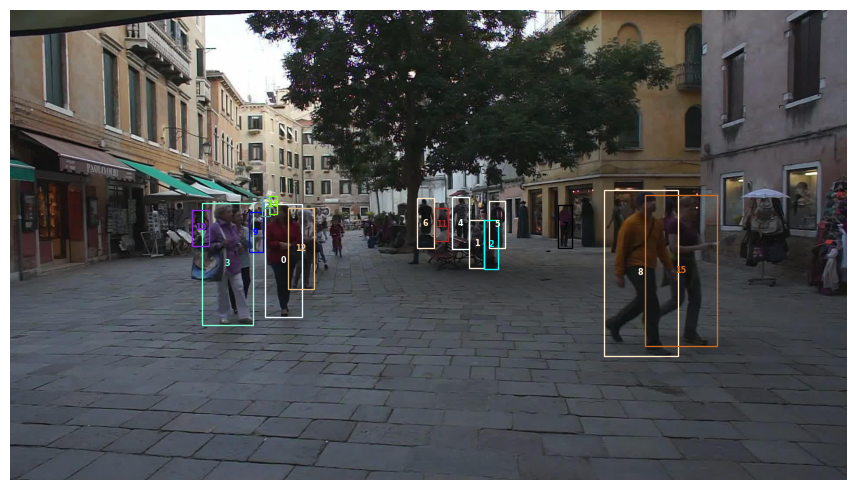

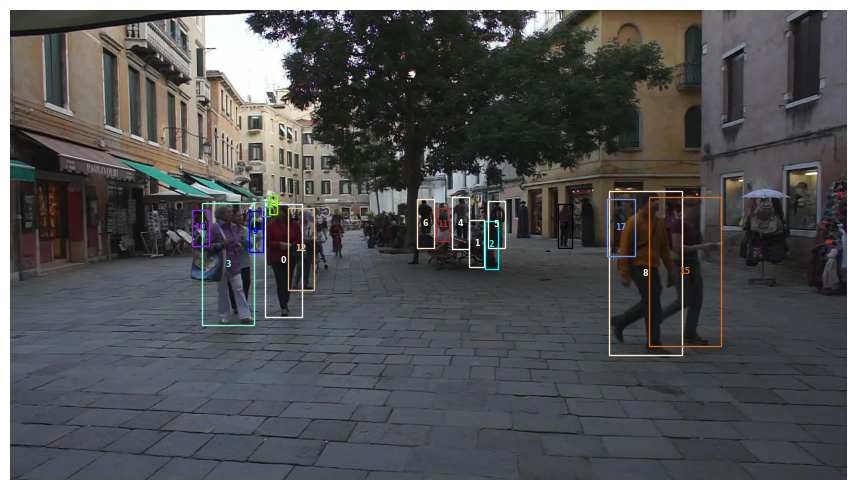

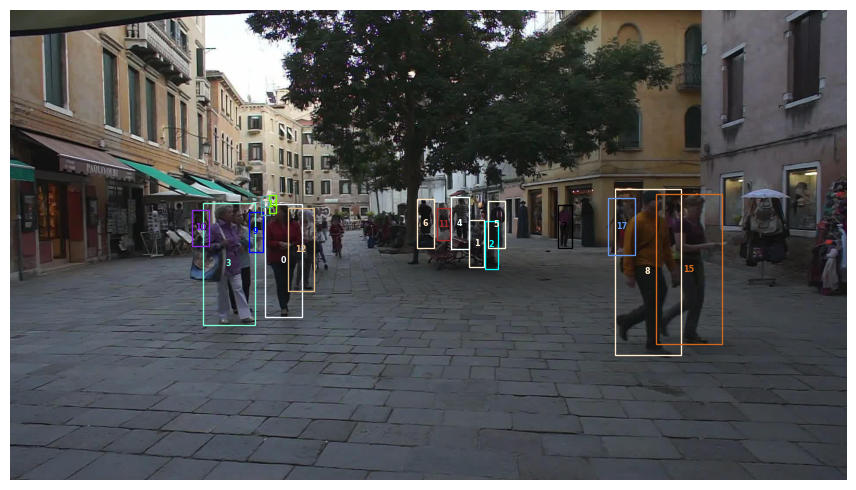

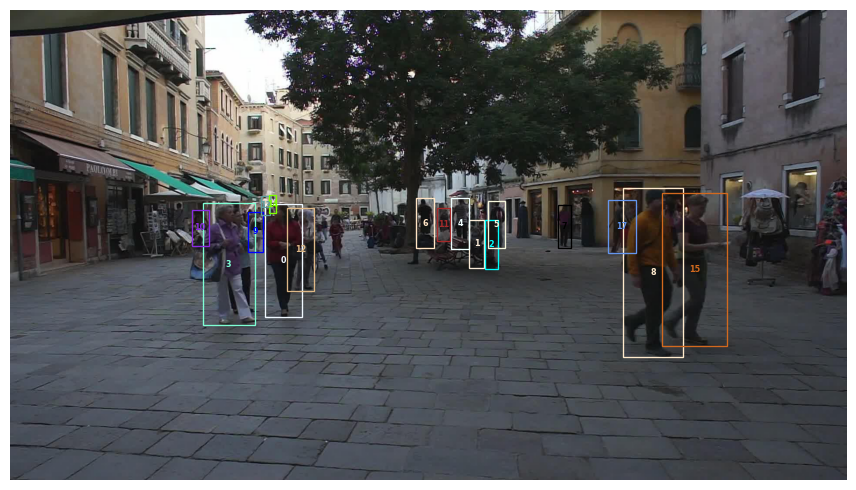

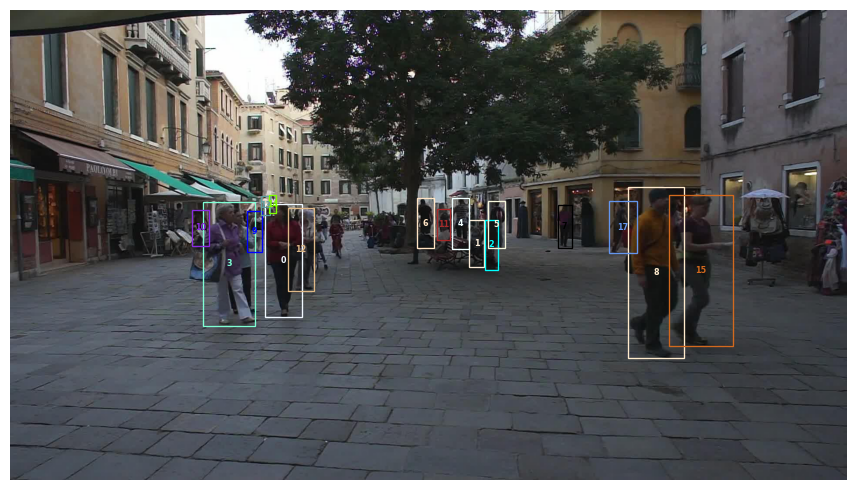

In [13]:
plot_sequence(reid_tracker_results_seq['MOT16-02'],
              [s for s in sequences if str(s) == 'MOT16-02'][0],
              first_n_frames=10)

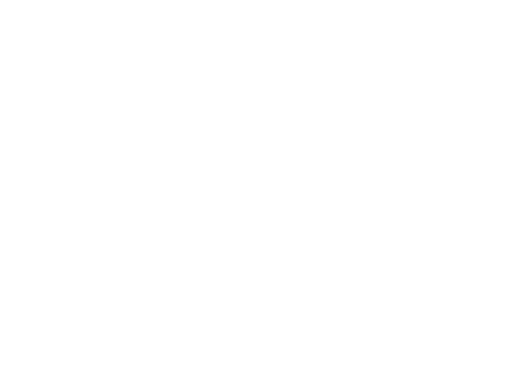

In [1]:
seq_name = 'MOT16-02'
# sequences = MOT16Sequences(seq_name, data_dir, load_seg=True)
c=0
for seq in sequences:
    for i, frame in enumerate(seq):
        img = frame['img']
        
        dpi = 96
        fig, ax = plt.subplots(1, dpi=dpi)

        img = img.mul(255).permute(1, 2, 0).byte().numpy()
        width, height, _ = img.shape
          
        ax.imshow(img, cmap='gray')
        fig.set_size_inches(width / dpi, height / dpi)

        if 'gt' in frame:
            gt = frame['gt']
            for gt_id, box in gt.items():
                rect = plt.Rectangle(
                  (box[0], box[1]),
                  box[2] - box[0],
                  box[3] - box[1],
                  fill=False,
                  linewidth=1.0)
                ax.add_patch(rect)

        plt.axis('off')
        plt.show()

        if 'seg_img' in frame:
            seg_img = frame['seg_img']
            fig, ax = plt.subplots(1, dpi=dpi)
            fig.set_size_inches(width / dpi, height / dpi)
            ax.imshow(seg_img, cmap='gray')
            plt.axis('off')
            plt.show()
        
        break
    break

NameError: name 'sequences' is not defined